In [1]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
import plotly
from plotly import tools
import plotly.express as px
from scipy.stats import boxcox
from plotly.offline import init_notebook_mode, iplot
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [133]:
df = pd.read_csv("application_data.csv",low_memory=False)
df.head()


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [3]:
pa = pd.read_csv(r"C:\Users\kimay\Downloads\previous_application.csv",low_memory=False) ##Previous Application
pa.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
pa.shape

(1670214, 37)

In [5]:
pa.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,...,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,...,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,...,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,...,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,...,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,...,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,...,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,...,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,...,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


In [6]:
df.shape

(307511, 122)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [8]:
df.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [9]:
#Finding total null values
null = df.isnull().sum()
null.sort_values

<bound method Series.sort_values of SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
                              ...  
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
Length: 122, dtype: int64>

In [10]:
#Null value percentages
per_null=df.isnull().sum()/len(df)*100
per_null.sort_values(ascending=False).head(25)

COMMONAREA_MEDI             69.872297
COMMONAREA_AVG              69.872297
COMMONAREA_MODE             69.872297
NONLIVINGAPARTMENTS_MODE    69.432963
NONLIVINGAPARTMENTS_AVG     69.432963
NONLIVINGAPARTMENTS_MEDI    69.432963
FONDKAPREMONT_MODE          68.386172
LIVINGAPARTMENTS_MODE       68.354953
LIVINGAPARTMENTS_AVG        68.354953
LIVINGAPARTMENTS_MEDI       68.354953
FLOORSMIN_AVG               67.848630
FLOORSMIN_MODE              67.848630
FLOORSMIN_MEDI              67.848630
YEARS_BUILD_MEDI            66.497784
YEARS_BUILD_MODE            66.497784
YEARS_BUILD_AVG             66.497784
OWN_CAR_AGE                 65.990810
LANDAREA_MEDI               59.376738
LANDAREA_MODE               59.376738
LANDAREA_AVG                59.376738
BASEMENTAREA_MEDI           58.515956
BASEMENTAREA_AVG            58.515956
BASEMENTAREA_MODE           58.515956
EXT_SOURCE_1                56.381073
NONLIVINGAREA_MODE          55.179164
dtype: float64

In [11]:
#Lets consider 40% as the threshold for the null values
#Columns having more than 40% null values
nullcol=df.isnull().sum()
nullcol=nullcol[nullcol.values>(0.40*len(nullcol))]
len(nullcol)

64

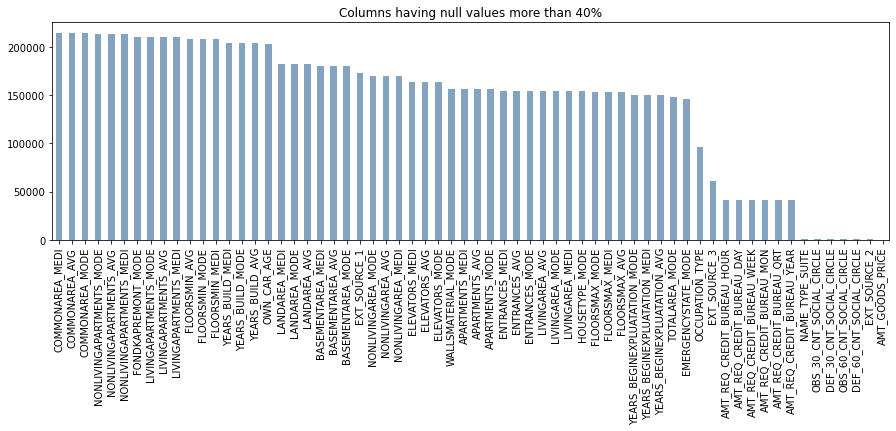

In [12]:
##Showing the values in a graphical form
nullcol=df.isnull().sum().sort_values(ascending=False)
nullcol=nullcol[nullcol.values>(0.40*len(nullcol))]
plt.figure(figsize=(15,4))
nullcol.plot(kind='bar',color=(0.2, 0.4, 0.6, 0.6))
plt.title('Columns having null values more than 40%')
plt.show()

In [13]:
df.isnull().sum()/len(df)*100

SK_ID_CURR                     0.000000
TARGET                         0.000000
NAME_CONTRACT_TYPE             0.000000
CODE_GENDER                    0.000000
FLAG_OWN_CAR                   0.000000
                                ...    
AMT_REQ_CREDIT_BUREAU_DAY     13.501631
AMT_REQ_CREDIT_BUREAU_WEEK    13.501631
AMT_REQ_CREDIT_BUREAU_MON     13.501631
AMT_REQ_CREDIT_BUREAU_QRT     13.501631
AMT_REQ_CREDIT_BUREAU_YEAR    13.501631
Length: 122, dtype: float64

In [14]:
#dropping the null value tables
empty = list(nullcol[nullcol.values>=0.4].index)
df.drop(labels=empty,axis=1,inplace=True)
print(len(empty))

64


In [15]:
df.isnull().sum()/len(df)*100

SK_ID_CURR                     0.000000
TARGET                         0.000000
NAME_CONTRACT_TYPE             0.000000
CODE_GENDER                    0.000000
FLAG_OWN_CAR                   0.000000
FLAG_OWN_REALTY                0.000000
CNT_CHILDREN                   0.000000
AMT_INCOME_TOTAL               0.000000
AMT_CREDIT                     0.000000
AMT_ANNUITY                    0.003902
NAME_INCOME_TYPE               0.000000
NAME_EDUCATION_TYPE            0.000000
NAME_FAMILY_STATUS             0.000000
NAME_HOUSING_TYPE              0.000000
REGION_POPULATION_RELATIVE     0.000000
DAYS_BIRTH                     0.000000
DAYS_EMPLOYED                  0.000000
DAYS_REGISTRATION              0.000000
DAYS_ID_PUBLISH                0.000000
FLAG_MOBIL                     0.000000
FLAG_EMP_PHONE                 0.000000
FLAG_WORK_PHONE                0.000000
FLAG_CONT_MOBILE               0.000000
FLAG_PHONE                     0.000000
FLAG_EMAIL                     0.000000


In [16]:
# The above shows that all the null values have been cleaned
## Also, as seen above, columns such as 'AMT_ANNUITY,'CNT_FAM_MEMBERS','DAYS_LAST_PHONE_CHANGE' have missing values. As to fill the missing values, we dont use mean as the data is skewed. Thus we can use median to fill the missing values in these cases
values1=df['AMT_ANNUITY'].median()
df.loc[df['AMT_ANNUITY'].isnull(),'AMT_ANNUITY']=values1

In [17]:
values2=df['CNT_FAM_MEMBERS'].median()
df.loc[df['CNT_FAM_MEMBERS'].isnull(),'CNT_FAM_MEMBERS']=values2

In [18]:
df.loc[df['CNT_FAM_MEMBERS'].isnull(),'CNT_FAM_MEMBERS']=values2

In [19]:
#to see if any columns with null values are remaining 
df.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
FLAG_MOBIL                     0
FLAG_EMP_PHONE                 0
FLAG_WORK_PHONE                0
FLAG_CONT_MOBILE               0
FLAG_PHONE                     0
FLAG_EMAIL                     0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_PROCESS_START        0
REG_REGION

In [20]:
##Now, for the values that have XNA in their fields. XNA translates to not available
#lets check out these the first column ie Gender
#for the total counts
df.CODE_GENDER.value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [21]:
#As the Female columns are more, replacing the XNA values with value F makes sense as it wont affect the database much
df.loc[df.CODE_GENDER == 'XNA','CODE_GENDER'] = 'F'

In [22]:
#FOR the column Organization
df['ORGANIZATION_TYPE'].describe()

count                     307511
unique                        58
top       Business Entity Type 3
freq                       67992
Name: ORGANIZATION_TYPE, dtype: object

In [23]:
df['ORGANIZATION_TYPE'].value_counts()

Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transpor

In [24]:
##Out of 307511 columns, only 17-18% columns have XNA. Dropping these wont affect the analysis and the database overall
df=df.drop(df.loc[df['ORGANIZATION_TYPE']=='XNA'].index)
df[df['ORGANIZATION_TYPE']=='XNA']

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21


In [25]:
##Now we will BIN the values that are continous so that it will be easier to plot them later
##For the given credit amount
bins = [0,25000,50000,75000,100000,125000,150000,175000,200000,225000,250000,275000,300000,325000,350000,375000,400000,425000,450000,475000,500000,10000000000]
slot = ['0-25000', '25000-50000','50000-75000','75000,100000','100000-125000', '125000-150000', '150000-175000','175000-200000',
       '200000-225000','225000-250000','250000-275000','275000-300000','300000-325000','325000-350000','350000-375000',
       '375000-400000','400000-425000','425000-450000','450000-475000','475000-500000','500000 and above']

df['AMT_INCOME_RANGE']=pd.cut(df['AMT_INCOME_TOTAL'],bins,labels=slot)

In [26]:
##Creating bins for the income amount
bins = [0,150000,200000,250000,300000,350000,400000,450000,500000,550000,600000,650000,700000,750000,800000,850000,900000,1000000000]
slots = ['0-150000', '150000-200000','200000-250000', '250000-300000', '300000-350000', '350000-400000','400000-450000',
        '450000-500000','500000-550000','550000-600000','600000-650000','650000-700000','700000-750000','750000-800000',
        '800000-850000','850000-900000','900000 and above']

df['AMT_CREDIT_RANGE']=pd.cut(df['AMT_CREDIT'],bins=bins,labels=slots)

In [27]:
#lets take cl1 for client with payment difficulties and cl2 for others
cl1_df = df.loc[df.TARGET == 0]
cl2_df = df.loc[df.TARGET == 1]
#as for the imbalance ratio
round(len(cl1_df)/len(cl2_df),2)

10.55

In [31]:
## Now as the data is cleaned (null and N/A values are removed), lets move on to Analyzing the data
## Outlier for the income column 
import plotly.express as px
fig = px.box(df, y="AMT_INCOME_TOTAL",title='Distribution of AMT_INCOME_TOTAL' )
fig.show()

In [32]:
# from the above we can conclude that 117M for amt_income is an outlier
# for AMT_ANNUITY that shows the loan annutity has the following outliers
fig = px.box(df, y="AMT_ANNUITY",title='AMT_ANNUITY distribution' )
fig.show()
#This shows that the value 258K is an outlier

In [33]:
#Now to find the outliers in the registration days
fig = px.box(df, y="DAYS_REGISTRATION", title='Distribution of DAYS_REGISTRATION',)
fig.show()
#this shows the difference in day before he/she regestired and submitted the application. 24000 days surely being a outlier

In [34]:
#Treating the outliers for the above three variables.
#Excluding values outside 99 percentile in each of the 3 variables
otl1= df['AMT_INCOME_TOTAL'].quantile(0.99)
df[df['AMT_INCOME_TOTAL'] < otl1]
otl2= df['AMT_ANNUITY'].quantile(0.99)
df[df['AMT_ANNUITY'] < otl2]
otl3= df['DAYS_REGISTRATION'].quantile(0.99)
df[df['DAYS_REGISTRATION'] < otl2]

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_INCOME_RANGE,AMT_CREDIT_RANGE
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0,0,0,0,200000-225000,400000-450000
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0,0,0,0,250000-275000,900000 and above
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0,0,0,0,50000-75000,0-150000
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,0,0,0,0,125000-150000,300000-350000
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0,0,0,0,100000-125000,500000-550000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307504,456248,0,Cash loans,F,N,Y,0,153000.0,331920.0,16096.5,...,0,0,0,0,0,0,0,0,150000-175000,300000-350000
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,0,0,0,0,0,150000-175000,250000-300000
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,0,0,0,0,0,150000-175000,650000-700000
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0,0,0,0,0,150000-175000,350000-400000


In [35]:
#### UNIVARIATE ANALYSIS ####

In [36]:
##Checking the distribution for univariate analysits, we create an object uniplot
def uniplot(df,col,title,hue =None):
    
    sns.set_style('whitegrid')
    sns.set_context('talk')
    plt.rcParams["axes.labelsize"] = 20
    plt.rcParams['axes.titlesize'] = 22
    plt.rcParams['axes.titlepad'] = 30
    
    
    temp = pd.Series(data = hue)
    fig, ax = plt.subplots()
    width = len(df[col].unique()) + 7 + 4*len(temp.unique())
    fig.set_size_inches(width , 8)
    plt.xticks(rotation=45)
    plt.yscale('log')
    plt.title(title)
    ax = sns.countplot(data = df, x= col, order=df[col].value_counts().index,hue = hue,palette='vlag') 
        
    plt.show()

In [37]:
##For Unordered Categorical Analysis
def plotf(var):
    plt.figure(figsize=(15,5))
    plt.subplot(1, 2, 1)
    sns.countplot(var, data=cl1_df,color=(0.2, 0.4, 0.6, 0.6))
    plt.title('Distribution of '+ '%s' %var +' for Non-Defaulters', fontsize=10)
    plt.xlabel(var)
    plt.xticks(rotation=90)
    plt.ylabel('Number of cases for non-defaulters')
    plt.subplot(1, 2, 2)
    sns.countplot(var, data=cl2_df, color=(0.4, 0.3, 0.5, 0.5))
    plt.title('Distribution of '+ '%s' %var +' for Defaulters', fontsize=10)
    plt.xlabel(var)
    plt.xticks(rotation=90)
    plt.ylabel('Total cases of defaulters')
    plt.show()

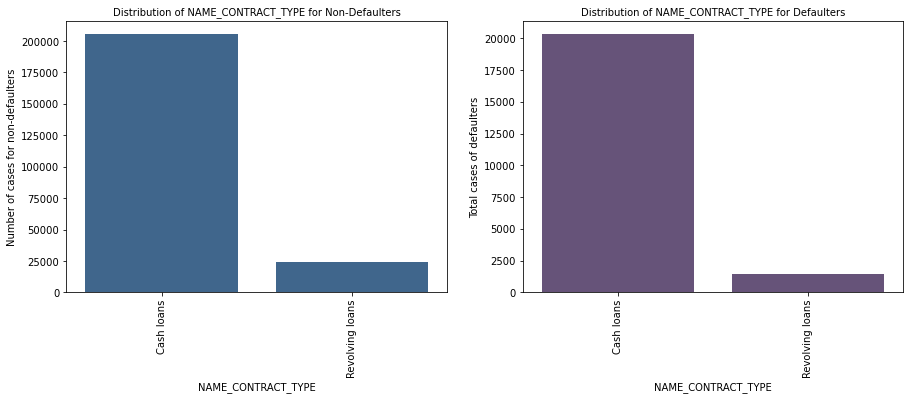

In [38]:
## Now lets get started with univariate unordered analysis 
##Lets start with the distribution for Non Defaulters and Defaulters
plotf('NAME_CONTRACT_TYPE')

In [39]:
# We can notice that revolving loans are lesser in the defaulted population. This points towards the fact that revolving loans are comparitively safer

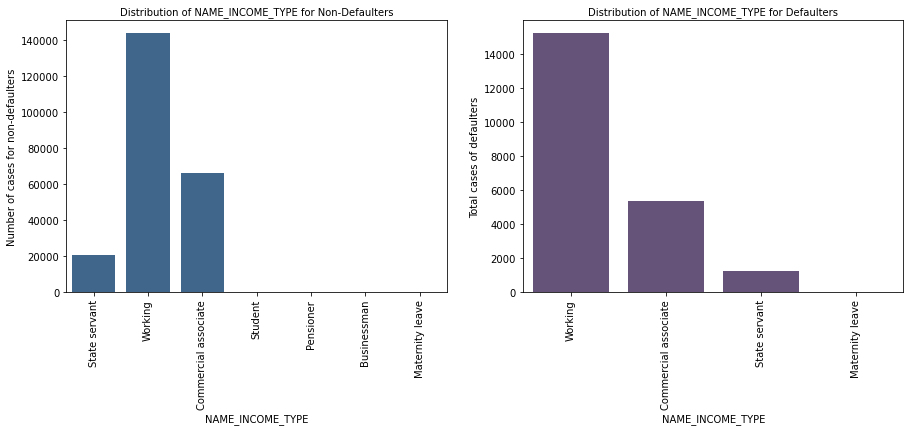

In [40]:
plotf('NAME_INCOME_TYPE')

In [41]:
# The income type shows most of the loans defaulters are the working types/professionals

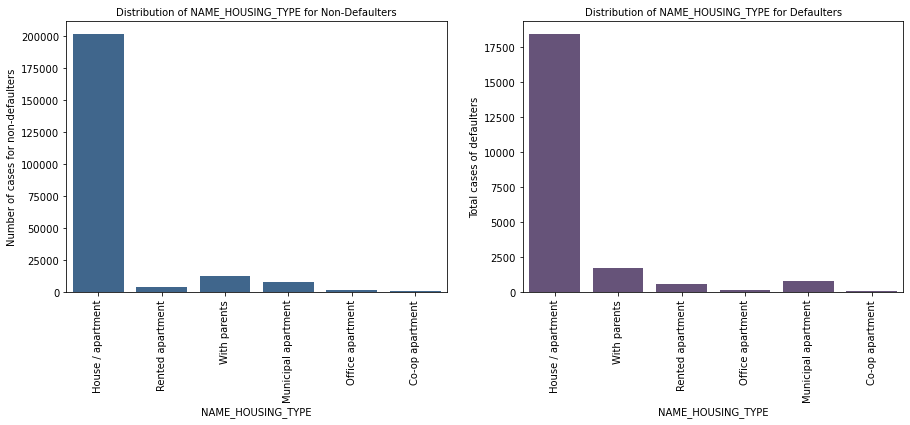

In [42]:
plotf('NAME_HOUSING_TYPE')

In [43]:
## People living in rented apartments and living with parents have high default rate. This is due to the fact the money goes for rental, and less money to repay the loan
# And as for people living with parents, it shows less income thus difficulty in paying the loans

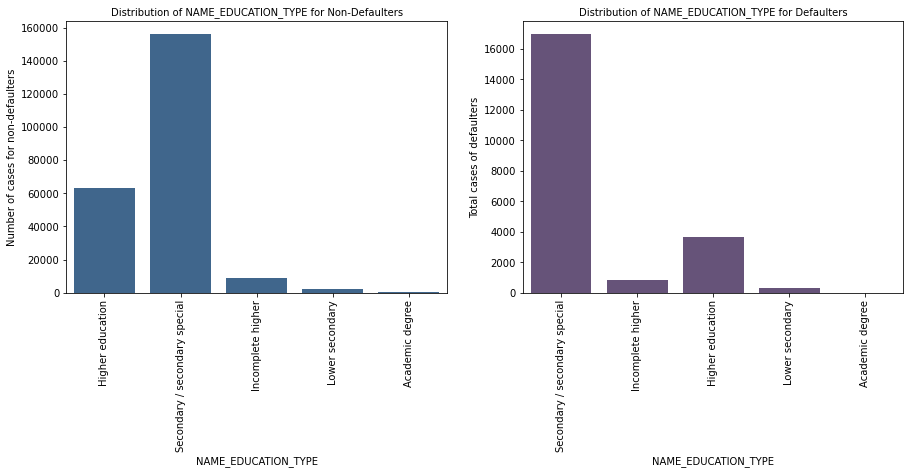

In [44]:
plotf('NAME_EDUCATION_TYPE')

In [45]:
## As higher education and special secondary requires loans ie student loans, the loans are higher.
#But in the case of higher education, most of the time there is a high chance of better income thus less default probablity

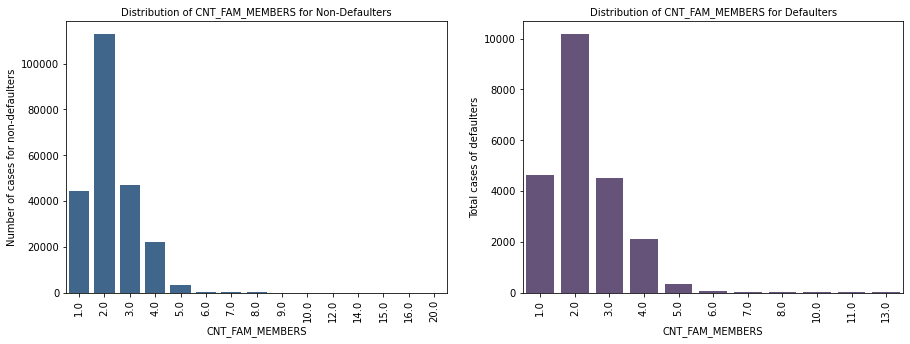

In [46]:
plotf('CNT_FAM_MEMBERS')

In [47]:
## The above shows the impact of total no of children is higher when it come to defaulters


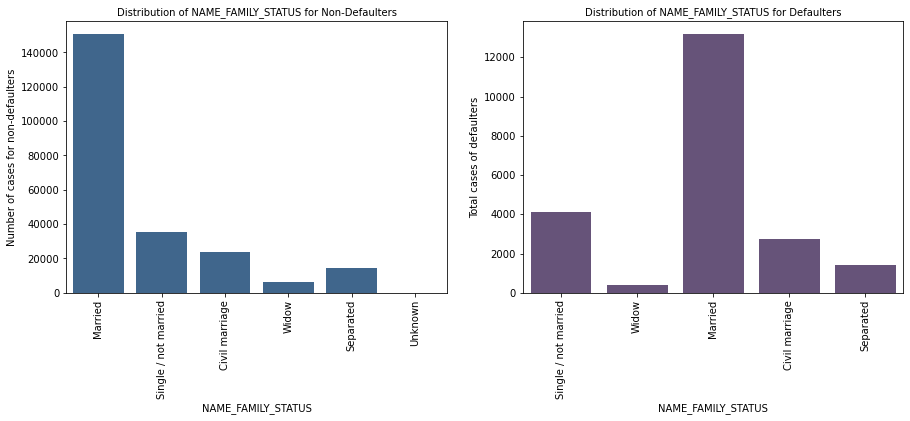

In [48]:
plotf('NAME_FAMILY_STATUS')

In [49]:
##The above list shows that married people tend to go more towards loans. But then again, they have a higher rate of paying them back. Single/not married people contribute around 14% and they can be the real issue as defaulters


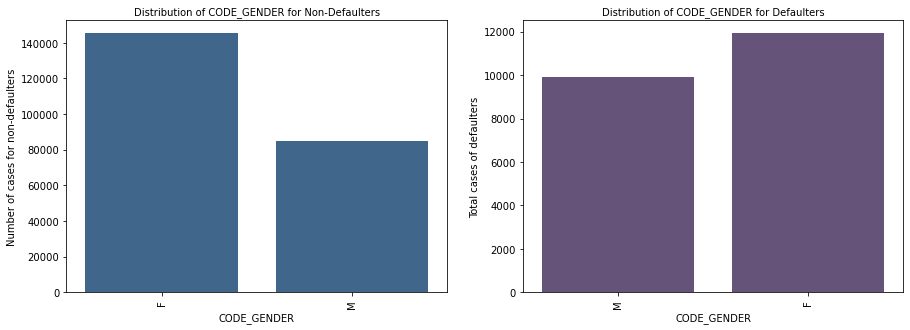

In [50]:
plotf('CODE_GENDER')

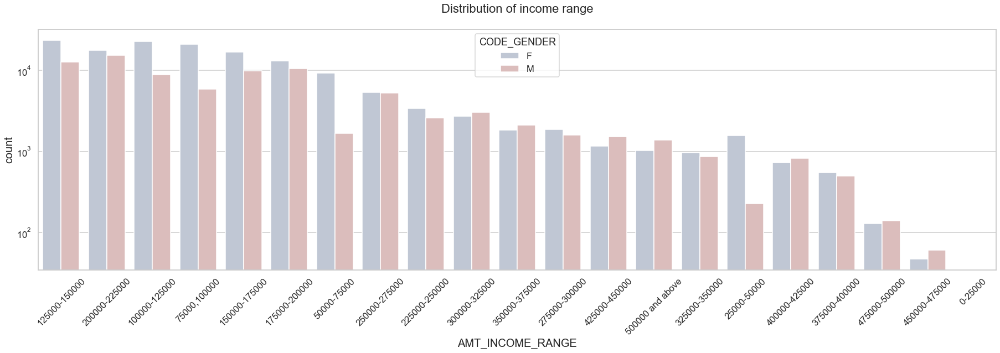

In [51]:
uniplot(cl1_df,col='AMT_INCOME_RANGE',title='Distribution of income range',hue='CODE_GENDER')

In [52]:
 #The above graph distribution shows that females have more credit than male for the given range
#Also, the income ranges of 1,00,000 to 2,00,000 have more credits

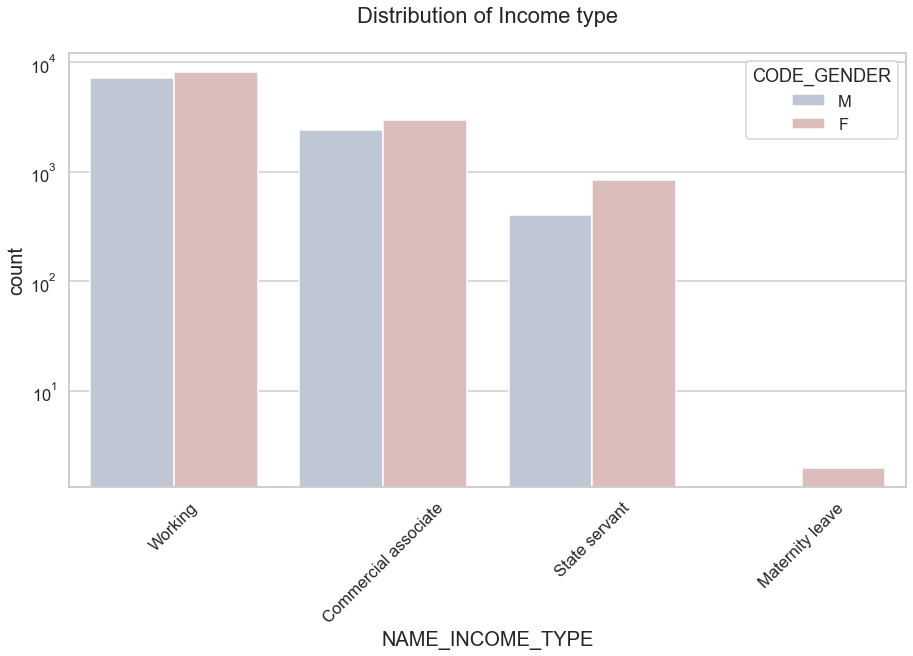

In [53]:
uniplot(cl2_df,col='NAME_INCOME_TYPE',title='Distribution of Income type',hue='CODE_GENDER')

In [55]:
#Now to check the gender distribution for Non Defaulters
colors = ['#4F6272', '#B7C3F3', '#DD7596', '#8EB897']
a0 = cl1_df["CODE_GENDER"].value_counts()
df = pd.DataFrame({'labels': a0.index,'values': a0.values})
df.iplot(kind='pie',labels='labels',values='values', title='Gender Distibution by Non Payment Difficulties', hole = 0.5,colors=colors)

In [56]:
## Now looking at the gender distribution for Defaulters
a1 = cl2_df["CODE_GENDER"].value_counts()
df = pd.DataFrame({'labels': a1.index,'values': a1.values})
df.iplot(kind='pie',labels='labels',values='values', title='Gender Distribution by  Payment Difficulties', hole = 0.5,colors=colors)

In [58]:
##Income source of loan by non payable
b0 = cl1_df["NAME_INCOME_TYPE"].value_counts()
df = pd.DataFrame({'labels': b0.index,'values': b0.values})
df.iplot(kind='pie',labels='labels',values='values', title='Income sources of Loan- Non Payment Difficulties', colors=colors)

In [213]:
##Income source of loan by payable 
b0 = cl2_df["NAME_INCOME_TYPE"].value_counts()
df = pd.DataFrame({'labels': b0.index,'values': b0.values})
df.iplot(kind='pie',labels='labels',values='values', title='Income sources of Loan- Payment Difficulties', colors=colors)

In [60]:
##Income source of loan by payable 
b0 = cl2_df["NAME_INCOME_TYPE"].value_counts()
df = pd.DataFrame({'labels': b0.index,'values': b0.values})
df.iplot(kind='pie',labels='labels',values='values', title='Income sources of Loan- Non Payment Difficulties', colors=colors)

In [61]:
#Now we calculate on the basis of Housing 
c1 = cl1_df["NAME_HOUSING_TYPE"].value_counts()
df = pd.DataFrame({'labels': c1.index,'values': c1.values})
df.iplot(kind='pie',labels='labels',values='values', title='Housing by Non- Loan Payment Difficulties', hole = 0.5,colors=colors)

In [62]:
c2 = cl2_df["NAME_HOUSING_TYPE"].value_counts()
df = pd.DataFrame({'labels': c2.index,'values': c2.values})
df.iplot(kind='pie',labels='labels',values='values', title='Housing by Loan Payment Difficulties', hole = 0.5,colors=colors)

## Here it can be observeed that an increase in the percentage of Payment Difficulties who live with their parents when compared to the percentages of Payment Difficulties and non-Payment Difficulties


In [214]:
#Organization by loan payment difficulties
d2 = cl1_df["ORGANIZATION_TYPE"].value_counts()
df = pd.DataFrame({'labels': d2.index,'values': d2.values})
df.iplot(kind='pie',labels='labels',values='values', title='Types of Organizations who applied for loan - Non-Payment Difficulties', hole = 0.5,colors=colors)

In [64]:
#Organization by loan payment difficulties
d2 = cl2_df["ORGANIZATION_TYPE"].value_counts()
df = pd.DataFrame({'labels': d2.index,'values': d2.values})
df.iplot(kind='pie',labels='labels',values='values', title='Types of Organizations who applied for loan - Non-Payment Difficulties', hole = 0.5,colors=colors)

In [65]:
#######  Univariate Analysis of of Numerical Variables on the basis of 'Target'      ###############


In [66]:
#we define an object called as univari
def univari(df,col,hue =None):
    sns.set(style="darkgrid")
    fig, ax=plt.subplots(nrows =1,ncols=2,figsize=(20,8))
    ax[0].set_title("Distribution Plot")
    sns.distplot(df[~df[col].isna()][col],ax=ax[0], color="#DD7596")
    plt.yscale('log')
    ax[1].set_title("Box Plot")
    sns.boxplot(data =df, x=col,ax=ax[1],orient='v', color="#DD7596")
    plt.yscale('log')
    plt.show()

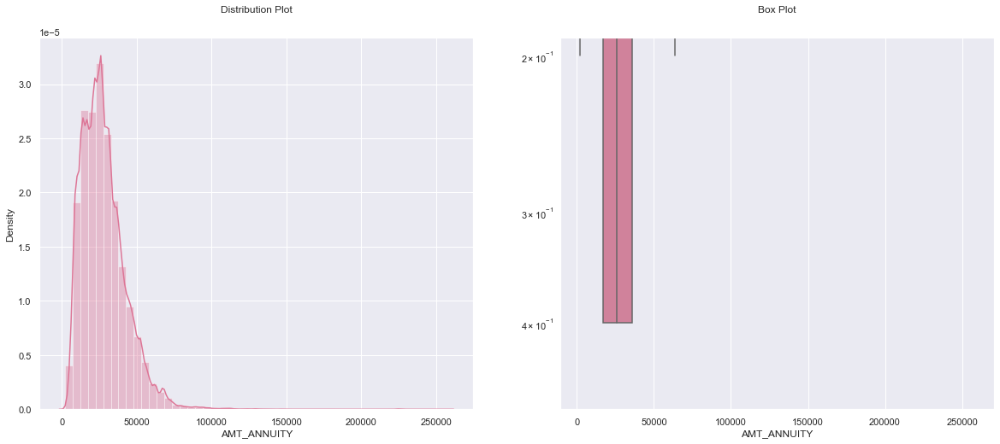

In [68]:
# Distribution and Box plot for 'AMT_ANNUITY' for Loan Non-Payment Difficulties
univari(df=cl1_df,col='AMT_ANNUITY')

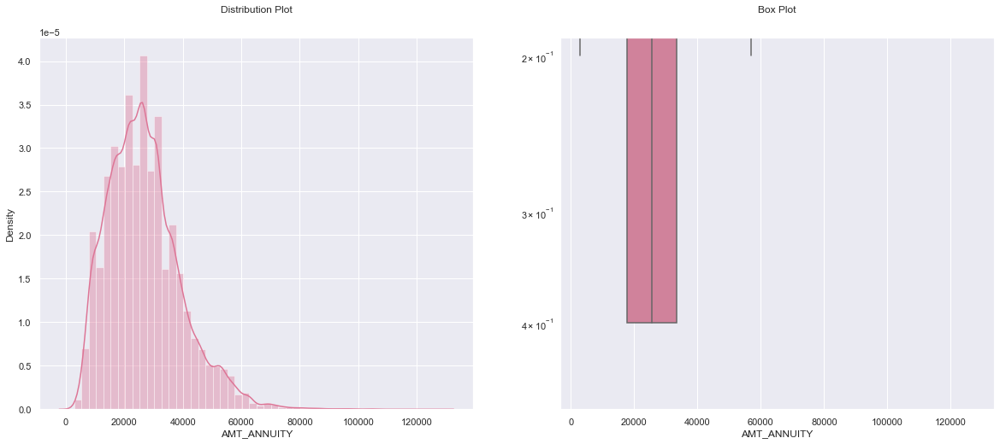

In [70]:
# Distribution and Box plot for 'AMT_ANNUITY' for Loan- Payment Difficulties
univari(df=cl2_df,col='AMT_ANNUITY')


In [71]:
#From the above plots, we can see that the annuity amount in the first quartile is greather than the third quartile
#It also shows that there are some outliers but they arent high enough to cause an hindrance

In [72]:
####    Bi Variate Analysis ##########

In [85]:
def plotbivar(var1,var2):

    plt.style.use('ggplot')
    sns.despine
    fig,(ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
    
    sns.scatterplot(x=var1, y=var2,data=cl1_df,ax=ax1)
    ax1.set_xlabel(var1)    
    ax1.set_ylabel(var2)
    ax1.set_title(f'{var1} vs {var2} for Non-Defaulters',fontsize=15)
    
    sns.scatterplot(x=var1, y=var2,data=cl2_df,ax=ax2)
    ax2.set_xlabel(var1)    
    ax2.set_ylabel(var2)
    ax2.set_title(f'{var1} vs {var2} for Defaulters',fontsize=15)
            
    plt.show()

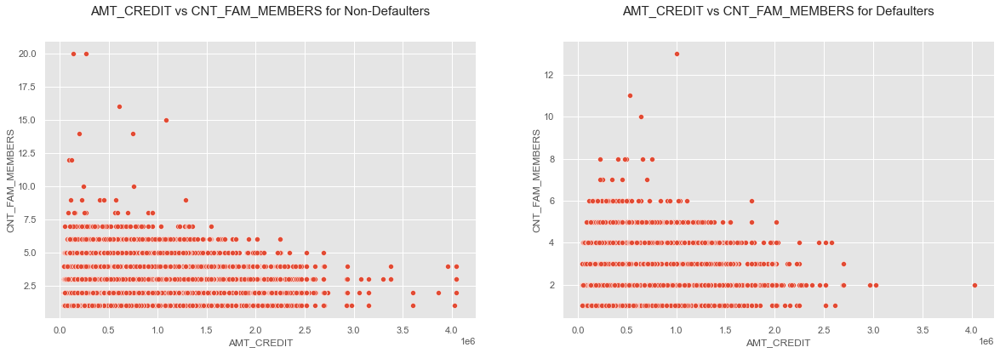

In [88]:
plotbivar('AMT_CREDIT','CNT_FAM_MEMBERS')

In [ ]:
## We can see that the density in the lower left corner is similar in both the case, so the people are equally likely to default if the family is small and the AMT_CREDIT is low. We can observe that larger families and people with larger AMT_CREDIT default less often



In [91]:
# 'AMT_INCOME_RANGE' vs 'AMT_CREDIT' for Loan - Non Payment Difficulties
fig = px.box(cl1_df, x="AMT_INCOME_RANGE", y="AMT_CREDIT", color='NAME_FAMILY_STATUS',
                title="Income range vs Credit amount of Loan Non- Payment Difficulties")

fig.show()

In [93]:
# 'AMT_INCOME_RANGE' vs 'AMT_CREDIT' for Loan Payment Difficulties
fig = px.box(cl2_df, x="AMT_INCOME_RANGE", y="AMT_CREDIT", color='NAME_FAMILY_STATUS',
                title="Income range vs Credit amount of Loan Payment Difficulties")

fig.show()

In [94]:
## Top correlation for clients with payment difficulties
corr=cl1_df[['AMT_INCOME_TOTAL','AMT_ANNUITY','DAYS_EMPLOYED',
  'DAYS_BIRTH', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
  'AMT_CREDIT']].corr(method = 'pearson')
corr=corr.where(np.triu(np.ones(corr.shape),k=1).astype(np.bool))
corr_df=corr.unstack().reset_index()

corr_df.columns = ['VAR1','VAR2','CORRELATION']
corr_df.dropna(subset=['CORRELATION'],inplace=True)
corr_df['CORR_ABS']=corr_df['CORRELATION'].abs()

In [95]:
corr_df.sort_values('CORR_ABS', ascending=False).head()

,VAR1,VAR2,CORRELATION,CORR_ABS
43,AMT_CREDIT,AMT_ANNUITY,0.762103,0.762103
7,AMT_ANNUITY,AMT_INCOME_TOTAL,0.400752,0.400752
23,DAYS_BIRTH,DAYS_EMPLOYED,0.352662,0.352662
42,AMT_CREDIT,AMT_INCOME_TOTAL,0.326155,0.326155
31,DAYS_REGISTRATION,DAYS_BIRTH,0.299000,0.299000


In [98]:
## Correlation heatmap ##
## for non defaulters
cl1_df[['AMT_INCOME_TOTAL','AMT_ANNUITY','DAYS_EMPLOYED','DAYS_BIRTH',
         'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
         'AMT_CREDIT',]].corr(method = 'pearson').iplot(kind='heatmap',colorscale="BuPu",title="Correlation Heatmap of Loan- Non Payment Difficulties")

In [101]:
## Heatmap for defaulters ##
cl2_df[['AMT_INCOME_TOTAL','AMT_ANNUITY','DAYS_EMPLOYED',
  'DAYS_BIRTH', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
  'AMT_CREDIT']].corr(method = 'pearson').iplot(kind='heatmap',colorscale="BuPu",title="Correlation Heatmap of Loan-Payment Difficulties")

In [102]:
#We observe that there is a high correlation between credit amount and goods price. 
# we can also observe that credit vs income creates discrepancies between Non payment and payment.

In [103]:
######## WORKING ON THE PREVIOUS DATA ###################

In [106]:
# Cleaning the missing data

# listing the null values columns having more than 40%

empty1=pa.isnull().sum()
empty1=empty1[empty1.values>(0.4*len(empty1))]
len(empty1)

15

In [107]:
#Removing the unwanted columns
empty1 = list(empty1[empty1.values>=0.3].index)
pa.drop(labels=empty1,axis=1,inplace=True)

pa.shape

(1670214, 22)

In [108]:
## Removing XNA and XAP

pa=pa.drop(pa[pa['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
pa=pa.drop(pa[pa['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
pa=pa.drop(pa[pa['NAME_CASH_LOAN_PURPOSE']=='XAP'].index)

pa.shape

(69635, 22)

In [129]:
pa.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 69635 entries, 4 to 1670206
Data columns (total 22 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   SK_ID_PREV                   69635 non-null  int64  
 1   SK_ID_CURR                   69635 non-null  int64  
 2   NAME_CONTRACT_TYPE           69635 non-null  object 
 3   AMT_APPLICATION              69635 non-null  float64
 4   AMT_CREDIT                   69635 non-null  float64
 5   WEEKDAY_APPR_PROCESS_START   69635 non-null  object 
 6   HOUR_APPR_PROCESS_START      69635 non-null  int64  
 7   FLAG_LAST_APPL_PER_CONTRACT  69635 non-null  object 
 8   NFLAG_LAST_APPL_IN_DAY       69635 non-null  int64  
 9   NAME_CASH_LOAN_PURPOSE       69635 non-null  object 
 10  NAME_CONTRACT_STATUS         69635 non-null  object 
 11  DAYS_DECISION                69635 non-null  int64  
 12  NAME_PAYMENT_TYPE            69635 non-null  object 
 13  CODE_REJECT_RE

In [139]:
### Performing univariate Analysis on the previous Data ###


SyntaxError: invalid syntax (Temp/ipykernel_2300/2469659607.py, line 1)

In [158]:
## Lets merge the 2 datasets
new_df = pd.merge(df,pa, how='left', on=['SK_ID_CURR'])

In [182]:
new_df.shape

(331007, 143)

In [191]:
## REMOVING XNA VALUES
new_df=new_df.drop(new_df[new_df['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
new_df=new_df.drop(new_df[new_df['NAME_CASH_LOAN_PURPOSE']=='XNA'].index)
new_df=new_df.drop(new_df[new_df['NAME_CASH_LOAN_PURPOSE']=='XAP'].index)
new_df=new_df.drop(new_df[new_df['NAME_CONTRACT_STATUS']=='XNA'].index)

new_df.shape

(331007, 143)

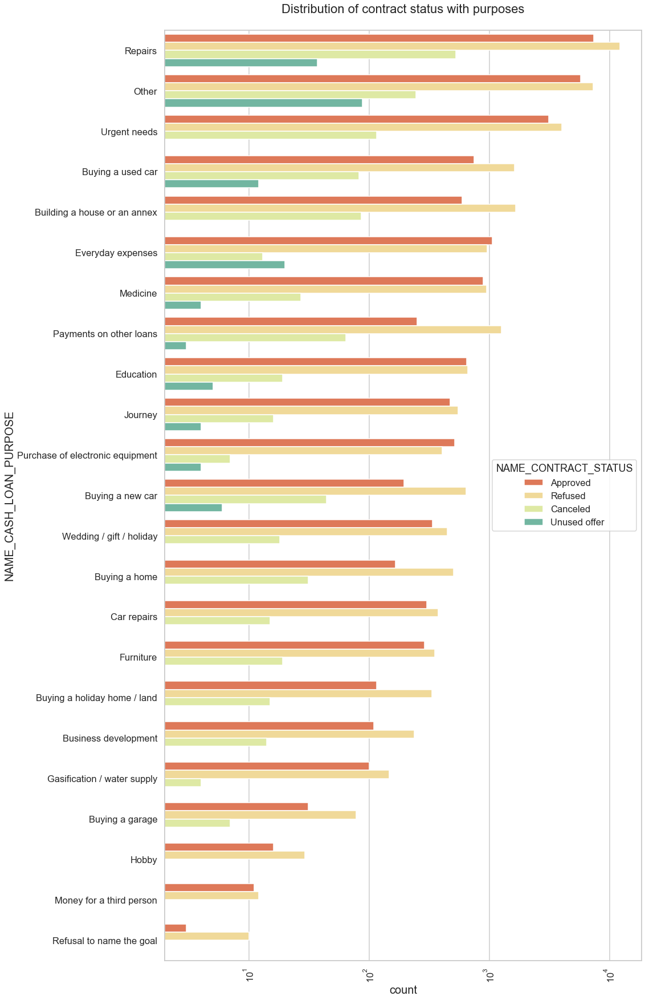

In [192]:
# Distribution of contract status in logarithmic scale

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(15,30))
plt.rcParams["axes.labelsize"] = 20
plt.rcParams['axes.titlesize'] = 22
plt.rcParams['axes.titlepad'] = 30
plt.xticks(rotation=90)
plt.xscale('log')
plt.title('Distribution of contract status with purposes')
ax = sns.countplot(data = new_df, y= 'NAME_CASH_LOAN_PURPOSE', 
                   order=new_df['NAME_CASH_LOAN_PURPOSE'].value_counts().index,hue = 'NAME_CONTRACT_STATUS',palette='Spectral') 

In [168]:
##Few points we can conclude from abpve plot:
# Loan purposes with 'Repairs' are facing more difficulites in payment on time.
# There are few places where loan payment is significant higher than facing difficulties. They are 'Buying a garage', 'Business developemt', 'Buying land','Buying a new car' and 'Education' Hence we can focus on these purposes for which the client is having for minimal payment difficulties.


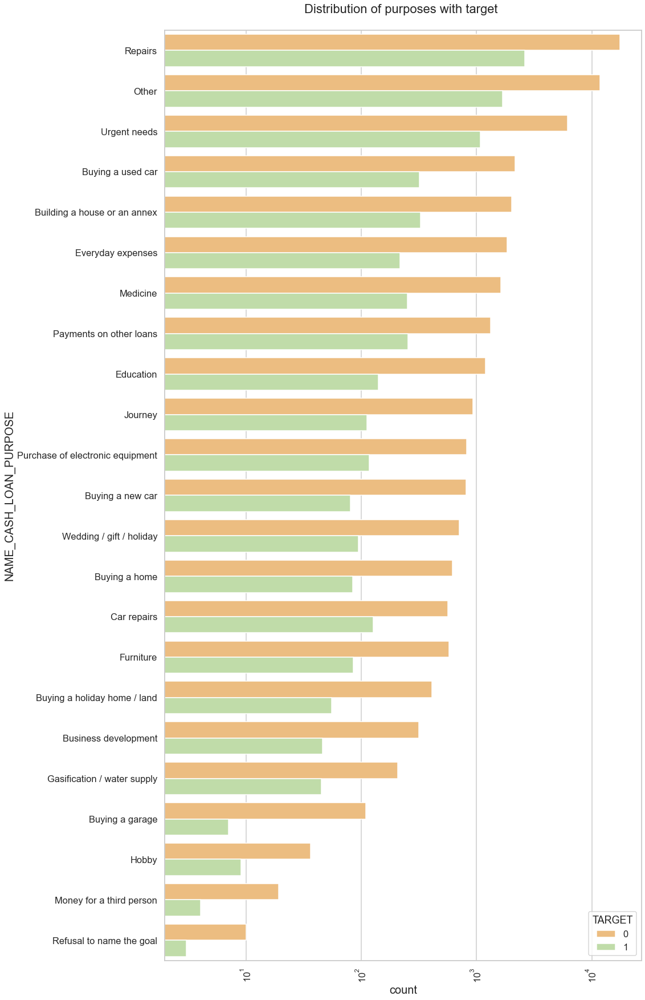

In [193]:
# Distribution of contract status with target

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(15,30))
plt.rcParams["axes.labelsize"] = 20
plt.rcParams['axes.titlesize'] = 22
plt.rcParams['axes.titlepad'] = 30
plt.xticks(rotation=90)
plt.xscale('log')
plt.title('Distribution of purposes with target ')
ax = sns.countplot(data = new_df, y= 'NAME_CASH_LOAN_PURPOSE', 
                   order=new_df['NAME_CASH_LOAN_PURPOSE'].value_counts().index,hue = 'TARGET',palette='Spectral') 

In [ ]:
##Few points we can conclude from abpve plot:
##Loan purposes with 'Repairs' are facing more difficulites in payment on time.
##There are few places where loan payment is significant higher than facing difficulties. They are 'Buying a garage', 'Business developemt', 'Buying land','Buying a new car' and 'Education' Hence we can focus on these purposes for which the client is having for minimal payment difficulties.



In [204]:
# Distribution of Contract Status and its category with maximum % of Loan-Payment Difficulties
biplot(new_df,'NAME_CONTRACT_STATUS', 'CONTRACT STATUS')



In [206]:
#From the first graph it can be seen that most of the contracts from previous application have been Approved

#It can be clearly seen from the second graph that the

#'Refused' contracts from previous application are the ones who have maximum % of Loan-Payment Difficulties from current application.
#'Approved' contracts from previous application are the ones who have minimum % of Loan-Payment Difficulties from current application.



In [209]:
biplot(new_df,'NAME_CASH_LOAN_PURPOSE', 'CASH LOAN PURPOSE')

In [210]:
# From the first graph it can be seen that purpose of cash loan from previous data was maximum for 'Repairs'

# It can be clearly seen from the second graph that the

#     'Refusal to name the goal' for cash loan from previous application are the ones who have maximum % of Loan-Payment Difficulties from current application.



In [211]:
## ##     INSIGHTS ## ###

In [212]:
# Target/focused variable for Application dataset - TARGET
# Target/focused variable for Previous dataset - NAME_CONTRACT_STATUS

In [ ]:


#     The count of ‘Maternity Leave’ in ‘NAME_INCOME_TYPE’ is very less and it also has maximum % of payment difficulties- around 40%. Hence, client with income type as ‘Maternity leave’ are the driving factors for Loan Defaulters.

#     The count of ‘Low skilled Laborers’ in ‘OCCUPATION_TYPE’ is comparatively very less and it also has maximum % of payment difficulties- around 17%. Hence, client with occupation type as ‘Low skilled Laborers’ are the driving factors for Loan Defaulters.

#     The count of ‘Lower Secondary’ in ‘NAME_EDUCATION_TYPE’ is comparatively very less and it also has maximum % of payment difficulties- around 11%. Hence, client with education type as ‘Lower Secondary’ are the driving factors for Loan Defaulters.

# 5.2 Previous Application Data

#     The count of ‘Refusal to name the goal’ in ‘NAME_CASH_LOAN_PURPOSE’ is comparatively very less and it also has maximum % of payment difficulties- around 23%. Hence, clients who have ‘Refused to name the goal’ for cash loan in previous application are the driving factors for Loan Defaulters.

#     The count of ‘Refused’ in ‘NAME_CONTRACT_STATUS’ is comparatively less and it also has maximum % of payment difficulties- around 12%. Hence, client with contract status as ‘Refused’ in previous application are the driving factors for Loan Defaulters.

#     The count of ‘Revolving Loans’ in ‘NAME_CONTRACT_TYPE’ is comparatively very less and it also has maximum % of payment difficulties- around 10%. Hence, client with contract type as ‘Revolving loans’ in previous application are the driving factors for Loan Defaulters.

#     It can be observed from the graph that Clients with 'Revolving loans' and with 'Refused' previous application tend to have more % of payment difficulties in current application. Since the count of both 'Revolving loans' and ‘Refused’ is comparatively less(from the graphs in previous slide), clients with ‘Revolving Loans’ and ‘Refused’ previous application are driving factors for Loan Defaulters

